In [1]:
# import necessary packages
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import torch
from torch.utils.data import DataLoader
import torch.nn.functional as F
import torch.nn as nn
import torch_geometric.utils
from torch_geometric.data import Data
from torch_geometric.nn import GATv2Conv
from sklearn.model_selection import KFold, train_test_split
from sklearn.cluster import SpectralClustering
from karateclub import Graph2Vec
import networkx as nx

from sklearn.metrics import mean_absolute_error
from scipy.stats import pearsonr
from scipy.spatial.distance import jensenshannon
from tqdm import tqdm
import random
import gc



/vol/bitbucket/meh23/.myenv/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
# set global variables
datapath = "dgl-icl" #for loading data – should be a directory name holding all the provided data files
dirpath = '' #for any exports
N_TRAIN = 167
N_TEST = 112
N_LR_NODES = 160
N_HR_NODES = 268
DEVICE = 'cuda' if torch.cuda.is_available() else 'cpu'

In [3]:
# Set a fixed random seed for reproducibility across multiple libraries
random_seed = 42
random.seed(random_seed)
np.random.seed(random_seed)
torch.manual_seed(random_seed)

# Check for CUDA (GPU support) and set device accordingly
if torch.cuda.is_available():
    device = torch.device("cuda")
    print("CUDA is available. Using GPU.")
    torch.cuda.manual_seed(random_seed)
    torch.cuda.manual_seed_all(random_seed)  # For multi-GPU setups
    # Additional settings for ensuring reproducibility on CUDA
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False
else:
    device = torch.device("cpu")
    print("CUDA not available. Using CPU.")

CUDA is available. Using GPU.


# Helper Functions

## Functions and Class for loading/saving in the data

In [4]:
class MatrixVectorizer:
    """
    A class for transforming between matrices and vector representations.
    
    This class provides methods to convert a symmetric matrix into a vector (vectorize)
    and to reconstruct the matrix from its vector form (anti_vectorize), focusing on 
    vertical (column-based) traversal and handling of elements.
    """

    def __init__(self):
        """
        Initializes the MatrixVectorizer instance.
        
        The constructor currently does not perform any actions but is included for 
        potential future extensions where initialization parameters might be required.
        """
        pass

    @staticmethod
    def vectorize(matrix, include_diagonal=False):
        """
        Converts a matrix into a vector by vertically extracting elements.
        
        This method traverses the matrix column by column, collecting elements from the
        upper triangle, and optionally includes the diagonal elements immediately below
        the main diagonal based on the include_diagonal flag.
        
        Parameters:
        - matrix (numpy.ndarray): The matrix to be vectorized.
        - include_diagonal (bool, optional): Flag to include diagonal elements in the vectorization.
          Defaults to False.
        
        Returns:
        - numpy.ndarray: The vectorized form of the matrix.
        """
        # Determine the size of the matrix based on its first dimension
        matrix_size = matrix.shape[0]

        # Initialize an empty list to accumulate vector elements
        vector_elements = []

        # Iterate over columns and then rows to collect the relevant elements
        for col in range(matrix_size):
            for row in range(matrix_size):
                # Skip diagonal elements if not including them
                if row != col:  
                    if row < col:
                        # Collect upper triangle elements
                        vector_elements.append(matrix[row, col])
                    elif include_diagonal and row == col + 1:
                        # Optionally include the diagonal elements immediately below the diagonal
                        vector_elements.append(matrix[row, col])

        return np.array(vector_elements)

    @staticmethod
    def anti_vectorize(vector, matrix_size, include_diagonal=False):
        """
        Reconstructs a matrix from its vector form, filling it vertically.
        
        The method fills the matrix by reflecting vector elements into the upper triangle
        and optionally including the diagonal elements based on the include_diagonal flag.
        
        Parameters:
        - vector (numpy.ndarray): The vector to be transformed into a matrix.
        - matrix_size (int): The size of the square matrix to be reconstructed.
        - include_diagonal (bool, optional): Flag to include diagonal elements in the reconstruction.
          Defaults to False.
        
        Returns:
        - numpy.ndarray: The reconstructed square matrix.
        """
        # Initialize a square matrix of zeros with the specified size
        matrix = np.zeros((matrix_size, matrix_size))

        # Index to keep track of the current position in the vector
        vector_idx = 0

        # Fill the matrix by iterating over columns and then rows
        for col in range(matrix_size):
            for row in range(matrix_size):
                # Skip diagonal elements if not including them
                if row != col:  
                    if row < col:
                        # Reflect vector elements into the upper triangle and its mirror in the lower triangle
                        matrix[row, col] = vector[vector_idx]
                        matrix[col, row] = vector[vector_idx]
                        vector_idx += 1
                    elif include_diagonal and row == col + 1:
                        # Optionally fill the diagonal elements after completing each column
                        matrix[row, col] = vector[vector_idx]
                        matrix[col, row] = vector[vector_idx]
                        vector_idx += 1

        return matrix

In [5]:
# functions for loading in the dataset
def multi_anti_vectorize(arr, vectorizer, matrix_size): 
    return np.array([vectorizer.anti_vectorize(v, matrix_size) for v in arr])

def load_data_tensor(path_to_datasets):
    # import data from .csv file
    hr_train_raw = pd.read_csv(path_to_datasets + '/hr_train.csv')
    lr_train_raw = pd.read_csv(path_to_datasets + '/lr_train.csv')
    lr_test_raw = pd.read_csv(path_to_datasets + '/lr_test.csv')

    # anti-vectorize 
    lr_n = 160
    hr_n = 268
    vectorizer = MatrixVectorizer()
    hr_train = multi_anti_vectorize(hr_train_raw.values, vectorizer, hr_n)
    lr_train = multi_anti_vectorize(lr_train_raw.values, vectorizer, lr_n)
    lr_test = multi_anti_vectorize(lr_test_raw.values, vectorizer, lr_n)

    # NOTE the order of return is low res train, low res test, high res train
    return torch.Tensor(lr_train), torch.Tensor(lr_test), torch.Tensor(hr_train)

In [6]:
# function for generating .csv file for the predictions
def generate_submission_file(prediction_tensors, filepath): 
    """
    Recommended file path is 'submission_files/xxxxxx.csv'
    """
    vectorizer = MatrixVectorizer()
    all_vectorized_arr = np.concatenate([vectorizer.vectorize(matrix) for matrix in prediction_tensors])
    df = pd.DataFrame({'ID': list(range(1, len(all_vectorized_arr)+1)), 'Predicted': all_vectorized_arr})
    df.to_csv(filepath, index=False)
    return df

In [7]:
#function for tracking gpu usage
def gpu_memory_usage():
    return [torch.cuda.mem_get_info()[0], torch.cuda.mem_get_info()[1]]

## Functions for data preparation

In [8]:
def adj_hop(adj, hop):
    adj_new = adj
    for i in range(hop-1):
        adj_new = torch.bmm(adj_new, adj)
    stack_adj = adj_new.reshape(-1,adj.shape[1])
    return stack_adj 


def upsampled_data(tensor, repeats, idxs):
    additional_samples = tensor[idxs, :, :]
    upsampled_tensor = torch.repeat_interleave(additional_samples, repeats=repeats, dim=0)
    return torch.cat([tensor, upsampled_tensor], dim=0)

def standardization(matrix, avg=None, std=None):
    if avg is None and std is None:
        avg = torch.mean(matrix)
        std = torch.std(matrix)
        return (matrix - avg)/std, avg, std
    else:
        return (matrix - avg)/std

## Functions for helping define and train the model

In [9]:
def generate_steps(num_steps, low=N_LR_NODES, high=N_HR_NODES):
    step_size = (high - low) / (num_steps - 1)
    steps_list = [round(low + step_size * i) for i in range(num_steps)]
    return steps_list

def freeze_model(model):
    for param in model.parameters():
        param.requires_grad = False

def unfreeze_model(model):
    for param in model.parameters():
        param.requires_grad = True

## Functions for visualisation of results

In [10]:
def generate_histogram(test_pred_tensor, target=None):
    flattened_tensor = test_pred_tensor.flatten() 
    # Create the histogram for predictions in purple
    plt.hist(flattened_tensor, alpha=0.5, bins=50, density=True, color='purple', label='Prediction')  
    if target is not None:
        flattened_target = target.flatten()
        # Create the histogram for ground truth in yellow
        plt.hist(flattened_target, bins=50, alpha=0.5, color='orange', label='Ground Truth', density=True)
    plt.xlabel('Value', fontsize=13)
    plt.ylabel('Frequency', fontsize=13)
    plt.legend(fontsize=13) # This will show the labels in the plot

    # Show the plot
    plt.show()

def generate_heatmap(single_tensor, save_path=None):
    """
    Produces heatmap of single tensor

    input:
    - sinlge_tensor: torch.tensor (single adjacency matrix)
    - save_path: string (optional) (string with file name)
    """
    assert len(single_tensor.shape) == 2, 'tensor dimensionality is greater than 2 - only pass one matrix'
    assert single_tensor.shape[0] == single_tensor.shape[1], 'tensor not square'
    plt.imshow(single_tensor, cmap='hot', interpolation='nearest')
    plt.colorbar()
    if save_path:
        plt.savefig(save_path)
    plt.show()

## Functions for evaluating model

In [11]:
def evaluate_predictions(tensor_pred, tensor_true):

    """ 
    tensor_pred and tensor_true should both be tensors of shape
    (num_val_samples, hr_dim, hr_dim).

    """
    # Initialize lists to store MAEs for each centrality measure
    mae_bc = []
    mae_ec = []
    mae_pc = []

    pred_1d_list = []
    gt_1d_list = []

    # Iterate over each test sample
    for i in tqdm(range(len(tensor_pred)), desc='Evaluating Predictions (Can be Slow)'):

        pred_matrix = tensor_pred[i].cpu().detach().numpy()
        true_matrix = tensor_true[i].cpu().detach().numpy()

        # Convert adjacency matrices to NetworkX graphs
        pred_graph = nx.from_numpy_matrix(pred_matrix)
        gt_graph = nx.from_numpy_matrix(true_matrix)

        # Compute centrality measures
        pred_bc = nx.betweenness_centrality(pred_graph, weight="weight")
        pred_ec = nx.eigenvector_centrality(pred_graph, weight="weight", max_iter=500)
        pred_pc = nx.pagerank(pred_graph, weight="weight")

        gt_bc = nx.betweenness_centrality(gt_graph, weight="weight")
        gt_ec = nx.eigenvector_centrality(gt_graph, weight="weight", max_iter=500)
        gt_pc = nx.pagerank(gt_graph, weight="weight")

        # Convert centrality dictionaries to lists
        pred_bc_values = list(pred_bc.values())
        pred_ec_values = list(pred_ec.values())
        pred_pc_values = list(pred_pc.values())

        gt_bc_values = list(gt_bc.values())
        gt_ec_values = list(gt_ec.values())
        gt_pc_values = list(gt_pc.values())

        # Compute MAEs
        mae_bc.append(mean_absolute_error(pred_bc_values, gt_bc_values))
        mae_ec.append(mean_absolute_error(pred_ec_values, gt_ec_values))
        mae_pc.append(mean_absolute_error(pred_pc_values, gt_pc_values))

        # Vectorize matrices
        pred_1d_list.append(MatrixVectorizer.vectorize(pred_matrix))
        gt_1d_list.append(MatrixVectorizer.vectorize(true_matrix))

    # Compute average MAEs
    avg_mae_bc = sum(mae_bc) / len(mae_bc)
    avg_mae_ec = sum(mae_ec) / len(mae_ec)
    avg_mae_pc = sum(mae_pc) / len(mae_pc)

    # Concatenate flattened matrices
    pred_1d = np.concatenate(pred_1d_list)
    gt_1d = np.concatenate(gt_1d_list)


    # Compute metrics
    mae = mean_absolute_error(pred_1d, gt_1d)
    pcc = pearsonr(pred_1d, gt_1d)[0]
    js_dis = jensenshannon(pred_1d, gt_1d)

    print("MAE: ", mae)
    print("PCC: ", pcc)
    print("Jensen-Shannon Distance: ", js_dis)
    print("Average MAE betweenness centrality:", avg_mae_bc)
    print("Average MAE eigenvector centrality:", avg_mae_ec)
    print("Average MAE PageRank centrality:", avg_mae_pc)
    
    all_metrics = {
        'mae': mae,
        'pcc': pcc,
        'js_dis': js_dis,
        'avg_mae_bc': avg_mae_bc,
        'avg_mae_ec': avg_mae_ec,
        'avg_mae_pc': avg_mae_pc,
    }
    
    return all_metrics

# Data Preparation

In [12]:
lr_train, lr_test, hr_train = load_data_tensor(datapath) # load in data from designated file path
train_idx, val_idx = train_test_split(list(range(len(lr_train))), test_size=0.2, shuffle=True, random_state=random_seed) # split data into training and validation set

## Learning initial node embeddings from adjacency matrix using VAE

### Prepare data for VAE models

In [13]:
# get the 3 hop adjacency matrices
lr_train3 = adj_hop(lr_train, 3)
hr_train3 = adj_hop(hr_train, 3)
lr_test3 = adj_hop(lr_test, 3)

In [14]:
# stack the matrices so they are by rows
lr_stack = lr_train.reshape(-1, N_LR_NODES)
hr_stack = hr_train.reshape(-1, N_HR_NODES)
lr_test_stack = lr_test.reshape(-1, N_LR_NODES)

lr_stack3 = lr_train3.reshape(-1, N_LR_NODES)
hr_stack3 = hr_train3.reshape(-1, N_HR_NODES)
lr_test_stack3 = lr_test3.reshape(-1, N_LR_NODES)

In [15]:
# standardise the values
lr_stack_norm, lr_avg, lr_std = standardization(lr_stack)
hr_stack_norm, temp1, temp2  = standardization(hr_stack)
lr_test_stack_norm = standardization(lr_test_stack, lr_avg, lr_std)

lr_stack3_norm, lr_avg3, lr_std3 = standardization(lr_stack3)
hr_stack3_norm, temp1, temp2 = standardization(hr_stack3)
lr_test_stack3_norm = standardization(lr_test_stack3, lr_avg3, lr_std3)

### Define VAE Models for both low and high resolution adjanceny matrices

In [16]:
class VAELR(nn.Module):
    def __init__(self):
        super().__init__()
        self.encoder = nn.Sequential(
            nn.Linear(N_LR_NODES, 128),
            nn.BatchNorm1d(128),
            nn.ReLU(),
            nn.Linear(128, 64),
            nn.BatchNorm1d(64),
            nn.ReLU(),

            nn.Sigmoid()

        )
        self.fc_m = nn.Linear(64,32)
        self.fc_std = nn.Linear(64,32)
        self.decoder = nn.Sequential(
            
            nn.Linear(32,64),
            nn.BatchNorm1d(64),
            nn.LeakyReLU(0.2),
            nn.Linear(64,128),
            nn.BatchNorm1d(128),
            nn.LeakyReLU(0.2),
            nn.Linear(128, N_LR_NODES)
        )
    def encode(self, x):
        h1 = self.encoder(x)
        return self.fc_m(h1), self.fc_std(h1)
    
    def reparametrize(self, mu, logvar):
        std = torch.exp(0.5*logvar)
        eps = torch.randn_like(std)
        return mu + eps*std
    
    def decode(self, z):
        return self.decoder(z)
    
    def forward(self, x):
        mu, logvar = self.encode(x)
        z = self.reparametrize(mu,logvar)
        return self.decode(z), mu, logvar
    

 
class VAEHR(nn.Module):
    def __init__(self):
        super(VAEHR, self).__init__()
        self.encoder = nn.Sequential(
            nn.Linear(N_HR_NODES, 256),
            nn.BatchNorm1d(256),
            nn.ReLU(),
            nn.Linear(256, 128),
            nn.BatchNorm1d(128),
            nn.ReLU(),
            nn.Linear(128,64),
            nn.BatchNorm1d(64),
            nn.ReLU(),

            nn.Sigmoid()

        )
        self.fc_m = nn.Linear(64,32)
        self.fc_std = nn.Linear(64,32)
        self.decoder = nn.Sequential(
            
            nn.Linear(32,64),
            nn.BatchNorm1d(64),
            nn.LeakyReLU(0.2),
            nn.Linear(64,128),
            nn.BatchNorm1d(128),
            nn.LeakyReLU(0.2),
            nn.Linear(128, 256),
            nn.BatchNorm1d(256),
            nn.LeakyReLU(0.2),
            nn.Linear(256, N_HR_NODES)
        )
    def encode(self, x):
        h1 = self.encoder(x)
        return self.fc_m(h1), self.fc_std(h1)
    
    def reparametrize(self, mu, logvar):
        std = torch.exp(0.5*logvar)
        eps = torch.randn_like(std)
        return mu + eps*std
    
    def decode(self, z):
        return self.decoder(z)
    
    def forward(self, x):
        mu, logvar = self.encode(x)
        z = self.reparametrize(mu,logvar)
        return self.decode(z), mu, logvar
           

In [17]:
def vae_loss(recon_x, x, mu, logvar):
    BCE = F.mse_loss(recon_x, x, reduction="sum")
    KLD = -0.5*torch.sum(1 + logvar - mu.pow(2) - logvar.exp())
    return BCE + KLD

def train(model, adj_matrix, num_epoch=200, lr=0.0001, batch_size=64):
    optimizer = torch.optim.AdamW(model.parameters(), lr=lr)
    for step in range(num_epoch):
        n_completed = 0
        while n_completed < len(adj_matrix):
            optimizer.zero_grad()
            batch = adj_matrix[n_completed: n_completed+batch_size]
            e, mu, logvar = model(batch)
            loss = vae_loss(e,batch, mu, logvar)
            loss.backward()
            print(loss)
            optimizer.step()
            n_completed += batch_size
    

### Train VAE models

In [18]:
# train for the low resolution 1-hop adjacency matrix
lr_vae = VAELR()
train(lr_vae, lr_stack_norm)

tensor(11304.5908, grad_fn=<AddBackward0>)
tensor(10385.1758, grad_fn=<AddBackward0>)
tensor(18837.4023, grad_fn=<AddBackward0>)
tensor(19987.9043, grad_fn=<AddBackward0>)
tensor(16995.3516, grad_fn=<AddBackward0>)
tensor(12509.6396, grad_fn=<AddBackward0>)
tensor(8982.4258, grad_fn=<AddBackward0>)
tensor(12595.5723, grad_fn=<AddBackward0>)
tensor(10993.4902, grad_fn=<AddBackward0>)
tensor(10536.6533, grad_fn=<AddBackward0>)
tensor(11077.2266, grad_fn=<AddBackward0>)
tensor(14923.1758, grad_fn=<AddBackward0>)
tensor(12393.7637, grad_fn=<AddBackward0>)
tensor(13505.1592, grad_fn=<AddBackward0>)
tensor(18022.7559, grad_fn=<AddBackward0>)
tensor(11217.3281, grad_fn=<AddBackward0>)
tensor(8731.1475, grad_fn=<AddBackward0>)
tensor(9186.2852, grad_fn=<AddBackward0>)
tensor(9824.0117, grad_fn=<AddBackward0>)
tensor(12105.4404, grad_fn=<AddBackward0>)
tensor(10500.4980, grad_fn=<AddBackward0>)
tensor(9182.9473, grad_fn=<AddBackward0>)
tensor(12955.3174, grad_fn=<AddBackward0>)
tensor(11142.691

In [19]:
# train for the high resolution 1-hop adjacency matrix
hr_vae = VAEHR()
train(hr_vae, hr_stack_norm)

tensor(19815.5527, grad_fn=<AddBackward0>)
tensor(16174.1670, grad_fn=<AddBackward0>)
tensor(17715.8320, grad_fn=<AddBackward0>)
tensor(16037.3125, grad_fn=<AddBackward0>)
tensor(33300.0664, grad_fn=<AddBackward0>)
tensor(33047.8164, grad_fn=<AddBackward0>)
tensor(28929.0977, grad_fn=<AddBackward0>)
tensor(35387.1445, grad_fn=<AddBackward0>)
tensor(19374.6289, grad_fn=<AddBackward0>)
tensor(18109.0352, grad_fn=<AddBackward0>)
tensor(16953.0469, grad_fn=<AddBackward0>)
tensor(18735.8574, grad_fn=<AddBackward0>)
tensor(17002.4727, grad_fn=<AddBackward0>)
tensor(19515.2305, grad_fn=<AddBackward0>)
tensor(18686.9258, grad_fn=<AddBackward0>)
tensor(18901.6133, grad_fn=<AddBackward0>)
tensor(18660.4180, grad_fn=<AddBackward0>)
tensor(21610.8691, grad_fn=<AddBackward0>)
tensor(18710.2246, grad_fn=<AddBackward0>)
tensor(22246.5879, grad_fn=<AddBackward0>)
tensor(19453.7305, grad_fn=<AddBackward0>)
tensor(25872.7461, grad_fn=<AddBackward0>)
tensor(22504.2520, grad_fn=<AddBackward0>)
tensor(2631

tensor(11058.2666, grad_fn=<AddBackward0>)
tensor(17549.4727, grad_fn=<AddBackward0>)
tensor(10202.2715, grad_fn=<AddBackward0>)
tensor(21442.1348, grad_fn=<AddBackward0>)
tensor(11998.9824, grad_fn=<AddBackward0>)
tensor(13949.6562, grad_fn=<AddBackward0>)
tensor(15791.0557, grad_fn=<AddBackward0>)
tensor(14712.9775, grad_fn=<AddBackward0>)
tensor(16331.0850, grad_fn=<AddBackward0>)
tensor(9507.5254, grad_fn=<AddBackward0>)
tensor(9545.1299, grad_fn=<AddBackward0>)
tensor(9767.8770, grad_fn=<AddBackward0>)
tensor(9368.4980, grad_fn=<AddBackward0>)
tensor(10290.1777, grad_fn=<AddBackward0>)
tensor(9622.7578, grad_fn=<AddBackward0>)
tensor(8803.3623, grad_fn=<AddBackward0>)
tensor(9534.6201, grad_fn=<AddBackward0>)
tensor(9145.9268, grad_fn=<AddBackward0>)
tensor(10177.7715, grad_fn=<AddBackward0>)
tensor(9518.9141, grad_fn=<AddBackward0>)
tensor(9630.5293, grad_fn=<AddBackward0>)
tensor(9161.2061, grad_fn=<AddBackward0>)
tensor(10597.7598, grad_fn=<AddBackward0>)
tensor(10264.7461, gra

In [20]:
# train for the low resolution 3-hop adjacency matrix
lr_vae3 = VAELR()
train(lr_vae, lr_stack3_norm)

tensor(6525.0889, grad_fn=<AddBackward0>)
tensor(6042.9883, grad_fn=<AddBackward0>)
tensor(6828.4487, grad_fn=<AddBackward0>)
tensor(8884.2188, grad_fn=<AddBackward0>)
tensor(4658.7998, grad_fn=<AddBackward0>)
tensor(3808.3545, grad_fn=<AddBackward0>)
tensor(4720.8540, grad_fn=<AddBackward0>)
tensor(4856.9199, grad_fn=<AddBackward0>)
tensor(6339.1123, grad_fn=<AddBackward0>)
tensor(7544.2188, grad_fn=<AddBackward0>)
tensor(6686.4673, grad_fn=<AddBackward0>)
tensor(4927.8545, grad_fn=<AddBackward0>)
tensor(4196.7524, grad_fn=<AddBackward0>)
tensor(7271.6919, grad_fn=<AddBackward0>)
tensor(13493.3828, grad_fn=<AddBackward0>)
tensor(6197.0273, grad_fn=<AddBackward0>)
tensor(6879.6865, grad_fn=<AddBackward0>)
tensor(6333.6011, grad_fn=<AddBackward0>)
tensor(6315.8047, grad_fn=<AddBackward0>)
tensor(5319.6001, grad_fn=<AddBackward0>)
tensor(3344.6665, grad_fn=<AddBackward0>)
tensor(3106.1904, grad_fn=<AddBackward0>)
tensor(3386.7036, grad_fn=<AddBackward0>)
tensor(2515.8052, grad_fn=<AddBac

tensor(4730.3281, grad_fn=<AddBackward0>)
tensor(15212.6045, grad_fn=<AddBackward0>)
tensor(4298.3120, grad_fn=<AddBackward0>)
tensor(2063.9304, grad_fn=<AddBackward0>)
tensor(2210.8049, grad_fn=<AddBackward0>)
tensor(1414.5901, grad_fn=<AddBackward0>)
tensor(5354.5503, grad_fn=<AddBackward0>)
tensor(2357.6367, grad_fn=<AddBackward0>)
tensor(1151.4009, grad_fn=<AddBackward0>)
tensor(2033.9832, grad_fn=<AddBackward0>)
tensor(1402.3167, grad_fn=<AddBackward0>)
tensor(3311.1731, grad_fn=<AddBackward0>)
tensor(2093.1272, grad_fn=<AddBackward0>)
tensor(12411.8154, grad_fn=<AddBackward0>)
tensor(8276.8125, grad_fn=<AddBackward0>)
tensor(15886.1016, grad_fn=<AddBackward0>)
tensor(30704.0156, grad_fn=<AddBackward0>)
tensor(20961.7949, grad_fn=<AddBackward0>)
tensor(3048.0120, grad_fn=<AddBackward0>)
tensor(2902.0305, grad_fn=<AddBackward0>)
tensor(1403.7205, grad_fn=<AddBackward0>)
tensor(2614.4419, grad_fn=<AddBackward0>)
tensor(1772.2437, grad_fn=<AddBackward0>)
tensor(5602.7114, grad_fn=<Ad

In [21]:
# train for the low resolution 3-hop adjacency matrix
hr_vae3 = VAEHR()
train(hr_vae3, hr_stack3_norm)

tensor(6721.3643, grad_fn=<AddBackward0>)
tensor(7566.0522, grad_fn=<AddBackward0>)
tensor(6455.6245, grad_fn=<AddBackward0>)


tensor(6488.4673, grad_fn=<AddBackward0>)
tensor(32566.5703, grad_fn=<AddBackward0>)
tensor(31476.4375, grad_fn=<AddBackward0>)
tensor(26227.1602, grad_fn=<AddBackward0>)
tensor(37867.1641, grad_fn=<AddBackward0>)
tensor(12096.6094, grad_fn=<AddBackward0>)
tensor(8280.0332, grad_fn=<AddBackward0>)
tensor(8623.2949, grad_fn=<AddBackward0>)
tensor(9363.3584, grad_fn=<AddBackward0>)
tensor(8714.0977, grad_fn=<AddBackward0>)
tensor(9890.7324, grad_fn=<AddBackward0>)
tensor(10371.6699, grad_fn=<AddBackward0>)
tensor(10627.3809, grad_fn=<AddBackward0>)
tensor(10194.6533, grad_fn=<AddBackward0>)
tensor(7950.8125, grad_fn=<AddBackward0>)
tensor(9564.2539, grad_fn=<AddBackward0>)
tensor(8842.6523, grad_fn=<AddBackward0>)
tensor(10485.3887, grad_fn=<AddBackward0>)
tensor(22597.3945, grad_fn=<AddBackward0>)
tensor(17708.7266, grad_fn=<AddBackward0>)
tensor(25189.9277, grad_fn=<AddBackward0>)
tensor(17502.4297, grad_fn=<AddBackward0>)
tensor(7114.1870, grad_fn=<AddBackward0>)
tensor(6948.2852, gra

### Obtain Embeddings

In [22]:
# get training embeddings from VAE based on low resolution 1-hop adjacency matrix
lr_vae.eval()
mu, logvar = lr_vae.encode(lr_stack_norm)
lr_X_dim1 = lr_vae.reparametrize(mu,logvar).reshape(N_TRAIN, N_LR_NODES, 32).detach()

In [23]:
# get training embeddings from VAE based on high resolution 1-hop adjacency matrix
hr_vae.eval()
mu, logvar = hr_vae.encode(hr_stack_norm)
hr_X_dim1 = hr_vae.reparametrize(mu,logvar).reshape(N_TRAIN, N_HR_NODES, 32).detach()

In [24]:
# get training embeddings from VAE based on low resolution 3-hop adjacency matrix
lr_vae3.eval()
mu, logvar = lr_vae3.encode(lr_stack3_norm)
lr_X_dim3 = lr_vae3.reparametrize(mu,logvar).reshape(N_TRAIN, N_LR_NODES, 32).detach()

In [25]:
# get training embeddings from VAE based on high resolution 3-hop adjacency matrix
hr_vae3.eval()
mu, logvar = hr_vae3.encode(hr_stack3_norm)
hr_X_dim3 = hr_vae3.reparametrize(mu,logvar).reshape(N_TRAIN, N_HR_NODES, 32).detach()

In [26]:
# get testing embeddings from VAE based on low resolution 1-hop adjacency matrix
lr_vae.eval()
mu, logvar = lr_vae.encode(lr_test_stack_norm)
lr_X_dim1_test = lr_vae.reparametrize(mu,logvar).reshape(N_TEST, N_LR_NODES, 32).detach()

In [27]:
# get testing embeddings from VAE based on low resolution 3-hop adjacency matrix
lr_vae3.eval()
mu, logvar = lr_vae3.encode(lr_test_stack3_norm)
lr_X_dim3_test = lr_vae3.reparametrize(mu,logvar).reshape(N_TEST, N_LR_NODES, 32).detach()

## Upsampling based on minority class from the HR adjacency matrix

In [28]:
def upsampling_idx(hr_train):
    hr_adj_list = [tensor.numpy() for tensor in hr_train]
    graphs = [nx.from_numpy_matrix(adj_matrix, create_using=nx.DiGraph) for adj_matrix in hr_adj_list]

    # generate embeddings for each graph
    graph2vec = Graph2Vec(dimensions=130)
    graph2vec.fit(graphs)
    graph_embeddings = graph2vec.get_embedding()

    # apply spectral clustering on the embeddings
    num_clusters = 2   # we only partition into majority and minority class
    clustering_model = SpectralClustering(n_clusters=num_clusters, assign_labels="discretize", random_state=random_seed)
    clusters = clustering_model.fit_predict(graph_embeddings)

    return list(np.where(clusters == 1)[0])

In [29]:
idxs = upsampling_idx(hr_train[train_idx])
repeats = 4 # add repeat the sample for 4 times each

# upsample the data
lr_train_up = upsampled_data(lr_train[train_idx], repeats, idxs)
hr_train_up = upsampled_data(hr_train[train_idx], repeats, idxs)
lr_X_dim1_train_up = upsampled_data(lr_X_dim1[train_idx], repeats, idxs)
hr_X_dim1_train_up = upsampled_data(hr_X_dim1[train_idx], repeats, idxs)
lr_X_dim3_train_up = upsampled_data(lr_X_dim3[train_idx], repeats, idxs)
hr_X_dim3_train_up = upsampled_data(hr_X_dim3[train_idx], repeats, idxs)

In [30]:
# load in data into a dataloader for training
trainloader = DataLoader(list(zip(lr_X_dim1_train_up, lr_X_dim3_train_up, lr_train_up, hr_X_dim1_train_up, hr_X_dim3_train_up, hr_train_up)), shuffle=True, batch_size=32)
valloader = DataLoader(list(zip(lr_X_dim1[val_idx], lr_X_dim3[val_idx], lr_train[val_idx], hr_train[val_idx])), shuffle=True, batch_size=32)
testloader = DataLoader(list(zip(lr_X_dim1_test, lr_X_dim3_test, lr_test)), shuffle=False, batch_size=32)

In [31]:
#delete VAE models to not run out of memory

del lr_vae
del hr_vae
del lr_vae3
del hr_vae3
gc.collect()

0

# Define main model

## Define layers used in the model

In [32]:
# Define module that stacks GCN layeres
class StackedGCN(nn.Module):
    def __init__(self, n_nodes, channel_ls, dropout):
        super().__init__()
        self.n_nodes = n_nodes
        self.gcn_layers, self.batch_norm_layers = self._init_layers(channel_ls)
        self.dropout = dropout
        
    def forward(self, X, A):
        for i in range(len(self.gcn_layers)):
            gcn = self.gcn_layers[i]
            batch_norm = self.batch_norm_layers[i]
            graph_batch = self._create_batch(X, A)
            
            X = F.sigmoid(gcn(graph_batch.x, graph_batch.edge_index, graph_batch.edge_attr).reshape(*X.shape[:2], -1))
            torch.cuda.empty_cache()
            X = F.dropout(batch_norm(X), self.dropout, training=self.training)
            torch.cuda.empty_cache()
        return X

    # initialise stacks of GCN layer -> batch normalisation
    def _init_layers(self, channel_ls):
        layers_ls = []
        batch_norm_ls = []
        for i in range(len(channel_ls) - 1):
            layer = GATv2Conv(channel_ls[i], channel_ls[i], heads=2, edge_dim=1)
            layers_ls.append(layer)
            batch_norm_ls.append(torch_geometric.nn.norm.BatchNorm(self.n_nodes, affine=False))
        return nn.ModuleList(layers_ls), nn.ModuleList(batch_norm_ls)

    # generate a Batch object for torch geometric
    def _create_batch(self, X, A):
        data_list = []
        for x, adj in zip(X, A):
            edge_index = adj.nonzero().t()
            edge_weights = adj[edge_index[0], edge_index[1]]
            data = Data(x=x, edge_index=edge_index, edge_attr=edge_weights.view(-1, 1))
            data_list.append(data)
        return torch_geometric.data.Batch().from_data_list(data_list)

In [33]:
# define layer that projects adjacency matrix and node embeddings to higher dimensions
class AdjacencyStep(nn.Module):
    def __init__(self, old_dim, new_dim, channels_ls, dt=1., alpha=0.9, gamma=0.9, dropout=0.5):
        super().__init__()
        self.dt = dt
        self.alpha = alpha
        self.gamma = gamma
        self.gnn = StackedGCN(old_dim, channels_ls, dropout).to(DEVICE)
        self.dropout = dropout
        self.dim_changer = nn.Parameter(torch.randn((new_dim, old_dim), device=DEVICE))

        self.A_dim_changer = nn.Parameter(torch.randn((new_dim, old_dim), device=DEVICE))
        self.A_dim_bias = nn.Parameter(torch.randn((new_dim, 1), device=DEVICE))

        self.Z_dim_changer = nn.Parameter(torch.randn((channels_ls[-1], new_dim), device=DEVICE))
        self.Z_dim_bias = nn.Parameter(torch.randn((new_dim, 1), device=DEVICE))
        self.Z_dim_lower = nn.Conv1d(channels_ls[-1], channels_ls[0], kernel_size=1)

        self.forget_gate = nn.Parameter(torch.randn(new_dim, device=DEVICE))
        self.input_gate = nn.Parameter(torch.randn(new_dim, device=DEVICE))

        self.batchnorm_A = torch_geometric.nn.norm.BatchNorm(new_dim)
        self.batchnorm_X = torch_geometric.nn.norm.BatchNorm(new_dim)
        self.batchnorm_Y = torch_geometric.nn.norm.BatchNorm(new_dim)

    def forward(self, X, Y, A):
        # update node features with gcn
        Z = self.gnn(X, A)
        torch.cuda.empty_cache()

        # forget gate from previous adjacency
        f = F.sigmoid(self.forget_gate)
        forget_A = F.elu(self.A_dim_changer @ A @ self.A_dim_changer.T + self.A_dim_bias)
        forget_A = f[:, None] * forget_A
        torch.cuda.empty_cache()

        # input gate from newly learnt node embeddings
        i = F.sigmoid(self.input_gate)
        input_Z = F.elu(self.dim_changer @ Z @ self.Z_dim_changer + self.Z_dim_bias)
        input_Z = i[:, None] * input_Z
        torch.cuda.empty_cache()

        # get new adjacency matrix
        new_A = forget_A + input_Z
        new_A = self.batchnorm_A(new_A)
        new_A = (new_A + torch.transpose(new_A, -1, -2)) / 2
        new_A = F.hardtanh(F.hardtanh(new_A, min_val=0), min_val=0)
        torch.cuda.empty_cache()

        # update feature embeiddings
        Z = torch.transpose(self.Z_dim_lower(torch.transpose(Z, -1, -2)), -1, -2)
        Y_temp = Y
        Y = self.dim_changer @ (Y + self.dt * (Z - self.alpha * Y - self.gamma * X))
        X = self.dim_changer @ (X + self.dt * Y_temp) 

        # add batch normalisation and dropout at the end
        X = self.batchnorm_X(X)
        Y = self.batchnorm_Y(Y)   
        Y = F.dropout(Y, self.dropout, training=self.training)
        X = F.dropout(X, self.dropout, training=self.training)
        return X, Y, new_A

    

In [34]:
# define module combines all the steps together
class AdjacencyDimChanger(nn.Module):
    def __init__(self, dim_steps, channels_ls):
        super().__init__()        
        self.layers = nn.ModuleList([AdjacencyStep(dim_steps[i], dim_steps[i+1], channels_ls) for i in range(len(dim_steps)-1)])
        
    def forward(self, X, Y, A):
        adj_ls = [A]
        for layer in self.layers:
            X, Y, A = layer(X, Y, A)
            adj_ls.append(A)
        return adj_ls

## Loss functions that will be calculated during training

In [35]:
def up_loss_fn(up_adj_ls, down_adj_ls,  gamma, epoch, a=0.95, b=0.5, c=0.1):
    total_loss = torch.Tensor([0]).to(DEVICE)
    mse_loss_fn = nn.MSELoss()

    # calculate the loss for the upper traingle of the matrix because thats what we care about
    final_dim = up_adj_ls[-1].shape[-1]
    upper_tri_idx = torch.triu_indices(final_dim, final_dim, offset=1)
    final_upper_tri_adj = up_adj_ls[-1][:,upper_tri_idx.unbind()[0], upper_tri_idx.unbind()[1]]
    final_upper_tri_other_adj = down_adj_ls[0][:,upper_tri_idx.unbind()[0], upper_tri_idx.unbind()[1]]
    final_mse_loss = mse_loss_fn(final_upper_tri_adj, final_upper_tri_other_adj)

    # calculate the loss for the remaining intermediate adj. matrices with larger weights on farther steps
    n = len(up_adj_ls[:-1])
    weights = torch.Tensor([2*(i+1)/(n*(n+1)) for i in range(n)])
    intermediate_mse_loss = torch.Tensor([0]).to(DEVICE)
    for i, (up_adj, down_adj) in enumerate(zip(up_adj_ls[:-1], down_adj_ls[1:][::-1])):
        intermediate_mse_loss = intermediate_mse_loss + weights[i] * mse_loss_fn(up_adj, down_adj)

    # sum up the two components of the loss with a weight alpha that decays over epochs
    alpha = (1 - np.exp(-c * epoch)) * (a - b) + b
    total_loss = total_loss + alpha * final_mse_loss + (1-alpha) * intermediate_mse_loss * (gamma ** 2)
    return total_loss

def down_loss_fn(down_adj_ls, up_adj_ls):
    total_loss = torch.Tensor([0]).to(DEVICE)
    mse_loss_fn = nn.MSELoss()

    # calculate the loss for each of the steps with equal weighting
    n = len(down_adj_ls[:])
    weights = torch.Tensor([1/n for i in range(n)])
    for i, (down_adj, up_adj) in enumerate(zip(down_adj_ls[:], up_adj_ls[::-1])):
        total_loss = total_loss + weights[i] * mse_loss_fn(down_adj, up_adj)
    return total_loss

def l1_regularization_loss(models, l1_lambda):
    l1_reg_loss = torch.Tensor([0]).to(DEVICE)
    for model in models:
        all_params = torch.cat([p.view(-1) for p in model.parameters()])
        l1_reg_loss = l1_reg_loss + l1_lambda * torch.norm(all_params, 1)
    return l1_reg_loss
    
def reconstruction_loss_fn(gt_adj, pred_adj):
    l1_loss_fn = nn.L1Loss()
    return l1_loss_fn(gt_adj, pred_adj)

def end_adj_loss_calc(adj, opp_adj):
    mae_loss_fn = torch.nn.L1Loss()
    n = len(adj)

    # calculate the upper triangular L1 loss for evaluation only
    upper_tri_idx = torch.triu_indices(n, n, offset=1)
    upper_tri_adj = adj.detach()[upper_tri_idx.unbind()]
    upper_tri_opp_adj = opp_adj.detach()[upper_tri_idx.unbind()]
    mae_loss = mae_loss_fn(upper_tri_adj, upper_tri_opp_adj)
    return mae_loss.detach().item()

## Define Training function

In [36]:
def train(epochs, up_changer, down_changer, trainloader, up_optimizer, down_optimizer, reconstruction_optimizer, valloader=None, completed_epochs=0, loss_log=None):

    if loss_log is None:
        loss_log = {'up': [], 'down': [], 'up_end_mae':[], 'down_end_mae':[], 'val_up_end_mae':[]}
    
    memory_log = []

    l1_lambda = 0.000001 # for L1 regularization
    for epoch in range(epochs):

        # for logging
        up_losses = []
        up_final_mae_ls = []
        down_final_mae_ls = []
        down_losses = []
        reconstruction_losses = []

        # change to training mode
        up_changer.train()
        down_changer.train() 
        
        memory_log.append(gpu_memory_usage())  
            
        for X_lr, Y_lr, adj_lr, X_hr, Y_hr, adj_hr in tqdm(trainloader, desc=f'Epoch {epoch} Train'):
        
            memory_log.append(gpu_memory_usage())  
            # train down changer
            freeze_model(up_changer)
            unfreeze_model(down_changer)
        
            down_optimizer.zero_grad()

            # forward pass
            up_adj_ls = up_changer(X_lr.to(DEVICE), Y_lr.to(DEVICE), adj_lr.to(DEVICE))
            torch.cuda.empty_cache()
            memory_log.append(gpu_memory_usage())  

            down_adj_ls = down_changer(X_hr.to(DEVICE), Y_hr.to(DEVICE), adj_hr.to(DEVICE))
            torch.cuda.empty_cache()
            memory_log.append(gpu_memory_usage())  

            # calculate total loss from down changer
            down_loss = down_loss_fn(down_adj_ls[1:], up_adj_ls[:-1]) + l1_regularization_loss([down_changer], l1_lambda)
            memory_log.append(gpu_memory_usage())  


            # for printing loss only
            down_final_mae_ls.append(end_adj_loss_calc(down_adj_ls[-1].detach(), up_adj_ls[0].detach()))
            torch.cuda.empty_cache()
            memory_log.append(gpu_memory_usage())  


            # backpropgate results
            down_loss.backward()
            memory_log.append(gpu_memory_usage())  
            down_optimizer.step()
            memory_log.append(gpu_memory_usage())  


            # log the results
            down_losses.append(down_loss.detach().item())
            del down_loss
            torch.cuda.empty_cache()

            memory_log.append(gpu_memory_usage())  

            # train up changer
            unfreeze_model(up_changer)
            freeze_model(down_changer)
        
            up_optimizer.zero_grad()

            # forward pass
            up_adj_ls = up_changer(X_lr.to(DEVICE), Y_lr.to(DEVICE), adj_lr.to(DEVICE))
            torch.cuda.empty_cache()
            memory_log.append(gpu_memory_usage())  

            down_adj_ls = down_changer(X_hr.to(DEVICE), Y_hr.to(DEVICE), adj_hr.to(DEVICE))
            torch.cuda.empty_cache()
            memory_log.append(gpu_memory_usage())  

        
            # calculate total loss from up changer
            up_loss = up_loss_fn(up_adj_ls[1:], down_adj_ls[:-1], gamma=1, epoch=epoch) + l1_regularization_loss([up_changer], l1_lambda)
            memory_log.append(gpu_memory_usage())  


            # for printing loss only
            up_final_mae_ls.append(end_adj_loss_calc(up_adj_ls[-1].detach(), down_adj_ls[0].detach()))
            torch.cuda.empty_cache()
            memory_log.append(gpu_memory_usage())  


            # backpropagate results
            up_loss.backward()
            memory_log.append(gpu_memory_usage())  

            up_optimizer.step()
            memory_log.append(gpu_memory_usage())  


            # log the results
            up_losses.append(up_loss.detach().item())
            del up_loss
            torch.cuda.empty_cache()

            memory_log.append(gpu_memory_usage())  

            # train both changer based on down-up reconstruction loss
            unfreeze_model(up_changer)
            unfreeze_model(down_changer)

            reconstruction_optimizer.zero_grad()

            # forward pass using the low dimension projection of high resolution adj as input to the up changer
            down_adj_end = down_changer(X_hr.to(DEVICE), Y_hr.to(DEVICE), adj_hr.to(DEVICE))[-1]
            torch.cuda.empty_cache()
            memory_log.append(gpu_memory_usage())  

            up_adj_end = up_changer(X_lr.to(DEVICE), Y_lr.to(DEVICE), down_adj_end)[-1]
            torch.cuda.empty_cache()
            memory_log.append(gpu_memory_usage())  


            # calculate the reconstruction loss and backpropagate the results
            reconstruction_loss = reconstruction_loss_fn(up_adj_end, adj_hr.to(DEVICE)) + l1_regularization_loss([up_changer, down_changer], l1_lambda) / 2
            memory_log.append(gpu_memory_usage())  

            reconstruction_loss.backward()
            memory_log.append(gpu_memory_usage())  

            reconstruction_optimizer.step()
            memory_log.append(gpu_memory_usage())  

            torch.cuda.empty_cache()

            # log the results
            reconstruction_losses.append(reconstruction_loss.detach().item())
            del reconstruction_loss
            torch.cuda.empty_cache()
        
        memory_log.append(gpu_memory_usage())  

        # do validation if necessary        
        if valloader is not None:
        
            val_up_final_mae_ls = []
        
            for X_lr, Y_lr, adj_lr, adj_hr in valloader:
                # change to eval mode
                up_changer.eval()

                memory_log.append(gpu_memory_usage())  
                freeze_model(up_changer)


                # evaluate the MAE from a single forward pass in up changer on validation data
                up_adj_ls = up_changer(X_lr.to(DEVICE), Y_lr.to(DEVICE), adj_lr.to(DEVICE))
                torch.cuda.empty_cache()
                memory_log.append(gpu_memory_usage())  

                val_up_final_mae_ls.append(end_adj_loss_calc(up_adj_ls[-1].detach(), adj_hr.to(DEVICE)))
            
            epoch_val_up_final_mae = np.mean(val_up_final_mae_ls)
            loss_log['val_up_end_mae'].append(epoch_val_up_final_mae)
            memory_log.append(gpu_memory_usage())  


    
        # for logging the results    
        epoch_up_loss = np.mean(up_losses)
        epoch_down_loss = np.mean(down_losses)
        epoch_reconstruction_loss = np.mean(reconstruction_losses)
        epoch_up_final_mae = np.mean(up_final_mae_ls)
        epoch_down_final_mae = np.mean(down_final_mae_ls)
        
        memory_log.append(gpu_memory_usage())  

        loss_log['up'].append(epoch_up_loss)
        loss_log['down'].append(epoch_down_loss)
        loss_log['up_end_mae'].append(epoch_up_final_mae)
        loss_log['down_end_mae'].append(epoch_down_final_mae)

        memory_log.append(gpu_memory_usage())  


        if (epoch + 1) % 5 == 0:
            print(f'ep{epoch}: DOWN L={epoch_down_loss}, UP L={epoch_up_loss}, RC L={epoch_reconstruction_loss}, DOWN MAE={epoch_down_final_mae}, UP MAE={epoch_up_final_mae}, UP VAL MAE={epoch_val_up_final_mae}')


    return up_changer, down_changer, loss_log, memory_log

# Model training

In [37]:
# define the model
dim_steps = generate_steps(num_steps=8)
channels_ls = [32, 64]

up_changer = AdjacencyDimChanger(dim_steps, channels_ls).to(DEVICE)
down_changer = AdjacencyDimChanger(dim_steps[::-1], channels_ls).to(DEVICE)

# define the optimisers
up_optimizer = torch.optim.AdamW(up_changer.parameters(), lr=0.002)
down_optimizer = torch.optim.AdamW(down_changer.parameters(), lr=0.002)
reconstruction_optimizer = torch.optim.AdamW(list(up_changer.parameters()) + list(down_changer.parameters()), lr=0.002)

# model size
sum(p.numel() for model in [up_changer, down_changer] for p in model.parameters())

1620176

In [38]:
# train model
gc.collect()
torch.cuda.empty_cache()


up_changer, down_changer, loss_log, memory_log = train(100, up_changer, down_changer, trainloader, up_optimizer, down_optimizer, reconstruction_optimizer, valloader=valloader)

Epoch 4 Train: 100%|██████████| 21/21 [00:36<00:00,  1.71s/it]


ep4: DOWN L=0.5887395427340553, UP L=0.6018021929831732, RC L=0.7221141911688305, DOWN MAE=0.21550923869723365, UP MAE=0.23087296812307267, UP VAL MAE=0.22000116109848022


Epoch 9 Train: 100%|██████████| 21/21 [00:31<00:00,  1.49s/it]


ep9: DOWN L=0.42425328493118286, UP L=0.43780736270404996, RC L=0.5347574778965541, DOWN MAE=0.20460705104328336, UP MAE=0.16705073912938437, UP VAL MAE=0.16516167670488358


Epoch 14 Train: 100%|██████████| 21/21 [00:29<00:00,  1.41s/it]


ep14: DOWN L=0.3007252287297022, UP L=0.334103585708709, RC L=0.42795411461875554, DOWN MAE=0.183720995982488, UP MAE=0.1554912059080033, UP VAL MAE=0.14153094589710236


Epoch 19 Train: 100%|██████████| 21/21 [00:28<00:00,  1.37s/it]


ep19: DOWN L=0.20497553476265498, UP L=0.26071777372133165, RC L=0.35091015980357215, DOWN MAE=0.18098310771442594, UP MAE=0.15234600859028952, UP VAL MAE=0.17912966758012772


Epoch 24 Train: 100%|██████████| 21/21 [00:27<00:00,  1.33s/it]


ep24: DOWN L=0.1398688086441585, UP L=0.20939624877203078, RC L=0.29360776855832055, DOWN MAE=0.17329673398108708, UP MAE=0.14593049812884556, UP VAL MAE=0.14554529637098312


Epoch 29 Train: 100%|██████████| 21/21 [00:27<00:00,  1.30s/it]


ep29: DOWN L=0.0944620750489689, UP L=0.17407602639425368, RC L=0.2556287348270416, DOWN MAE=0.1630989731777282, UP MAE=0.14566994635831743, UP VAL MAE=0.19368943572044373


Epoch 34 Train: 100%|██████████| 21/21 [00:27<00:00,  1.30s/it]


ep34: DOWN L=0.0635814613529614, UP L=0.14802064427307673, RC L=0.22724764971506028, DOWN MAE=0.15481191731634594, UP MAE=0.14214961585544406, UP VAL MAE=0.16638828068971634


Epoch 39 Train: 100%|██████████| 21/21 [00:28<00:00,  1.34s/it]


ep39: DOWN L=0.043434818230924155, UP L=0.12918236284028917, RC L=0.20788179905641646, DOWN MAE=0.1492239875452859, UP MAE=0.14049699689660752, UP VAL MAE=0.18271689862012863


Epoch 44 Train: 100%|██████████| 21/21 [00:29<00:00,  1.41s/it]


ep44: DOWN L=0.030347378658396856, UP L=0.11422730450119291, RC L=0.19290743697257268, DOWN MAE=0.14309598363581158, UP MAE=0.1375747493335179, UP VAL MAE=0.12479717656970024


Epoch 49 Train: 100%|██████████| 21/21 [00:31<00:00,  1.52s/it]


ep49: DOWN L=0.02202827048798402, UP L=0.10160430378857113, RC L=0.18077506266889118, DOWN MAE=0.14082623663402738, UP MAE=0.13466953663598924, UP VAL MAE=0.14716323465108871


Epoch 54 Train: 100%|██████████| 21/21 [00:35<00:00,  1.69s/it]


ep54: DOWN L=0.016713867673561686, UP L=0.09116677833454949, RC L=0.1713497049751736, DOWN MAE=0.14069855142207371, UP MAE=0.13348966375702903, UP VAL MAE=0.16194666177034378


Epoch 59 Train: 100%|██████████| 21/21 [00:38<00:00,  1.85s/it]


ep59: DOWN L=0.013227190423224653, UP L=0.08195870582546506, RC L=0.1639846463998159, DOWN MAE=0.14037637554463886, UP MAE=0.13272422481150853, UP VAL MAE=0.15929605066776276


Epoch 64 Train: 100%|██████████| 21/21 [00:43<00:00,  2.07s/it]


ep64: DOWN L=0.01127790930193095, UP L=0.07422814518213272, RC L=0.15755631597269149, DOWN MAE=0.13997474241824376, UP MAE=0.13017621281601133, UP VAL MAE=0.14629484713077545


Epoch 69 Train: 100%|██████████| 21/21 [00:45<00:00,  2.17s/it]


ep69: DOWN L=0.010056119545229844, UP L=0.06718680901186806, RC L=0.15121439666975112, DOWN MAE=0.1380862295627594, UP MAE=0.12888702714727038, UP VAL MAE=0.13814695924520493


Epoch 74 Train: 100%|██████████| 21/21 [00:48<00:00,  2.29s/it]


ep74: DOWN L=0.0093203235772394, UP L=0.061457457286970954, RC L=0.1461898060072036, DOWN MAE=0.13830554698194777, UP MAE=0.12758791836954297, UP VAL MAE=0.15308637917041779


Epoch 79 Train: 100%|██████████| 21/21 [00:49<00:00,  2.36s/it]


ep79: DOWN L=0.008882253253388973, UP L=0.0563780984708241, RC L=0.14142040340673356, DOWN MAE=0.1387874342146374, UP MAE=0.12429925870327722, UP VAL MAE=0.1245015524327755


Epoch 84 Train: 100%|██████████| 21/21 [00:50<00:00,  2.42s/it]


ep84: DOWN L=0.008563834686009656, UP L=0.05134105682373047, RC L=0.13499656248660313, DOWN MAE=0.13495370319911412, UP MAE=0.11869141494943983, UP VAL MAE=0.13299036771059036


Epoch 89 Train: 100%|██████████| 21/21 [00:51<00:00,  2.44s/it]


ep89: DOWN L=0.008450219141585487, UP L=0.04708259162448701, RC L=0.12933678995995296, DOWN MAE=0.13808939641430265, UP MAE=0.11638641321942919, UP VAL MAE=0.15383732318878174


Epoch 94 Train: 100%|██████████| 21/21 [00:52<00:00,  2.50s/it]


ep94: DOWN L=0.00820889969223312, UP L=0.04361024002234141, RC L=0.12496819950285412, DOWN MAE=0.13742948642798833, UP MAE=0.11232715206486839, UP VAL MAE=0.13431372120976448


Epoch 99 Train: 100%|██████████| 21/21 [00:52<00:00,  2.49s/it]


ep99: DOWN L=0.008046133465887536, UP L=0.040166650322221574, RC L=0.11992545106581279, DOWN MAE=0.13769768533252535, UP MAE=0.11104207734266917, UP VAL MAE=0.13686946034431458


In [39]:
memory_df = pd.DataFrame(memory_log)
average_memory_usage = memory_df.iloc[:, 0].mean()
max_memory_usage = memory_df.iloc[:, 0].max()

print(f'Average GPU memory usage: {round(average_memory_usage/1024**2, 2)} MB')
print(f'Maximum GPU memory usage: {round(max_memory_usage/1024**2, 2)} MB')

Average GPU memory usage: 7843.18 MB
Maximum GPU memory usage: 11801.0 MB


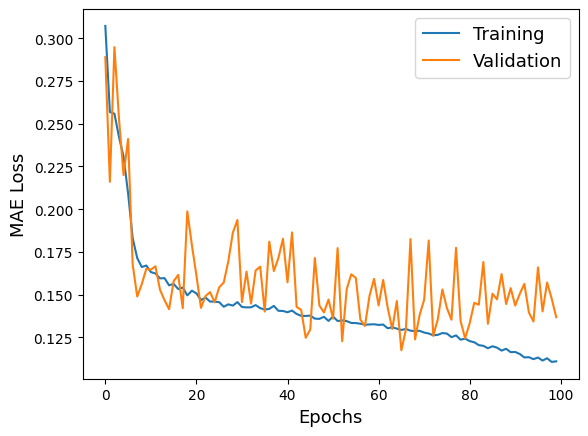

In [40]:
# plot loss curve
plt.plot(np.arange(len(loss_log['up_end_mae'])), loss_log['up_end_mae'], label='Training')
plt.plot(np.arange(len(loss_log['up_end_mae'])), loss_log['val_up_end_mae'], label='Validation')
plt.legend(fontsize=13)
plt.ylabel('MAE Loss', fontsize=13)
plt.xlabel('Epochs', fontsize=13)

#uncomment to save loss curve
#filepath = dirpath + f'losses.png' 
#plt.savefig(filepath, dpi=400)

plt.show()

# Generate predictions from trained model

In [41]:
# to generate test predictions
up_changer.eval()
test_predictions = []
for X_lr, Y_lr, adj_lr in tqdm(testloader):
    pred = up_changer(X_lr.to(DEVICE), Y_lr.to(DEVICE), adj_lr.to(DEVICE))[-1].detach()
    test_predictions.append(pred)
test_predictions = torch.cat(test_predictions)

filepath = dirpath + f'test_predictions.csv' 
df = generate_submission_file(test_predictions.cpu(), 'test_predictions.csv')


100%|██████████| 4/4 [00:00<00:00,  5.42it/s]


In [42]:
# to generate val predictions

one_sample_pred = None
one_sample_target = None
up_changer.eval()
val_predictions = []
for X_lr, Y_lr, adj_lr, adj_hr in tqdm(valloader):
    pred = up_changer(X_lr.to(DEVICE), Y_lr.to(DEVICE), adj_lr.to(DEVICE))[-1].detach()
    if one_sample_pred == None:
        one_sample_pred = pred[0]
        one_sample_target = adj_hr[0]
    val_predictions.append(pred)
val_predictions = torch.cat(val_predictions)


100%|██████████| 2/2 [00:00<00:00,  6.18it/s]


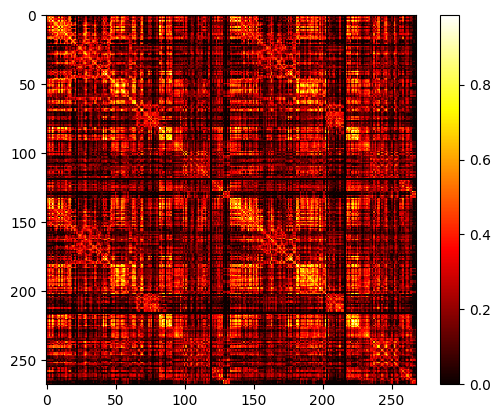

In [43]:
# generate heat map for prediction
generate_heatmap(one_sample_pred.cpu())

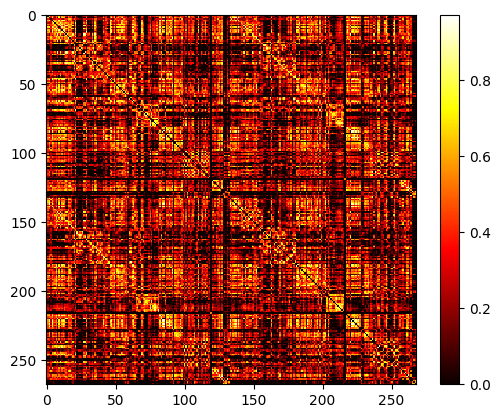

In [44]:
# generate heat map for ground truth
generate_heatmap(one_sample_target.cpu())

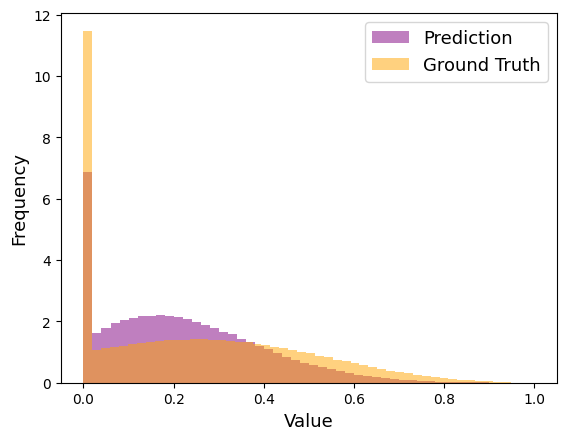

In [45]:
# compare distribution between predictions and training target data
generate_histogram(val_predictions.cpu(), hr_train[val_idx])

# Cross Validation

In [46]:
def validation(up_changer, testloader, val_adj_hr, fold_n, dirpath):
    print('begin validation')
    up_changer.eval()

    # generate predictions for test data
    val_predictions = []
    for X_lr, Y_lr, adj_lr in tqdm(testloader):
        pred = up_changer(X_lr.to(DEVICE), Y_lr.to(DEVICE), adj_lr.to(DEVICE))[-1].detach()
        val_predictions.append(pred)
    val_predictions = torch.cat(val_predictions)

    # generate .csv file for prediction from each fold
    filepath = dirpath + f'predictions_fold_{fold_n}.csv' 
    generate_submission_file(val_predictions.cpu(), filepath)

    # evaluate the performance of prediction
    return evaluate_predictions(val_predictions, val_adj_hr)

def cross_validate(epochs, batch_size, n_fold, X_lr, Y_lr, adj_lr, X_hr, Y_hr, adj_hr, dirpath, channels_ls=[32, 64], num_steps=8, lr=0.002):
    kf = KFold(n_fold, shuffle=True, random_state=random_seed)
    runs_results = []
    memory_logs = []
    for fold, (train_idx, val_idx) in enumerate(kf.split(X_lr)):

        # perform upsampling on training data
        idxs = upsampling_idx(hr_train[train_idx])
        repeats = 4 

        train_adj_lr = upsampled_data(adj_lr[train_idx], repeats, idxs)
        train_adj_hr = upsampled_data(adj_hr[train_idx], repeats, idxs)
        train_X_lr = upsampled_data(X_lr[train_idx], repeats, idxs)
        train_X_hr = upsampled_data(X_hr[train_idx], repeats, idxs)
        train_Y_lr = upsampled_data(Y_lr[train_idx], repeats, idxs)
        train_Y_hr = upsampled_data(Y_hr[train_idx], repeats, idxs)
        
        # split for validation data
        val_X_lr = X_lr[val_idx]
        val_Y_lr = Y_lr[val_idx]
        val_adj_lr = adj_lr[val_idx]
        val_adj_hr = adj_hr[val_idx]

        # load into DataLoader
        trainloader = DataLoader(list(zip(train_X_lr, train_Y_lr, train_adj_lr, train_X_hr, train_Y_hr, train_adj_hr)), shuffle=True, batch_size=batch_size)
        valloader = DataLoader(list(zip(val_X_lr, val_Y_lr, val_adj_lr, val_adj_hr)), shuffle=False, batch_size=batch_size)
        testloader = DataLoader(list(zip(val_X_lr, val_Y_lr, val_adj_lr)), shuffle=False, batch_size=batch_size)

        # define model
        dim_steps = generate_steps(num_steps=8)
        channels_ls = channels_ls
        up_changer = AdjacencyDimChanger(dim_steps, channels_ls).to(DEVICE)
        down_changer = AdjacencyDimChanger(dim_steps[::-1], channels_ls).to(DEVICE)

        # define the optimisers
        up_optimizer = torch.optim.AdamW(up_changer.parameters(), lr=lr)
        down_optimizer = torch.optim.AdamW(down_changer.parameters(), lr=lr)
        reconstruction_optimizer = torch.optim.AdamW(list(up_changer.parameters()) + list(down_changer.parameters()), lr=lr)

        # train model
        up_changer, down_changer, _, memory_log = train(epochs, up_changer, down_changer, trainloader, up_optimizer, down_optimizer, reconstruction_optimizer, valloader=valloader)

        # evaluate model
        val_metrics = validation(up_changer, testloader, val_adj_hr, fold+1, dirpath)
        runs_results.append(val_metrics)

        #append memory log
        memory_logs.append(memory_log)

    return runs_results, memory_log

In [47]:
#free up memory
gc.collect()

9447

In [48]:
# perform 3-fold cross validation
cv_results, memory_log = cross_validate(100, 32, 3, lr_X_dim1, lr_X_dim3, lr_train, hr_X_dim1, hr_X_dim3, hr_train, dirpath, channels_ls=[32, 64], num_steps=8, lr=0.002)

Epoch 4 Train: 100%|██████████| 4/4 [00:07<00:00,  1.94s/it]


ep4: DOWN L=0.7540691941976547, UP L=0.7396507412195206, RC L=0.8653384447097778, DOWN MAE=0.23581530526280403, UP MAE=0.2688978537917137, UP VAL MAE=0.25448358058929443


Epoch 9 Train: 100%|██████████| 4/4 [00:07<00:00,  1.81s/it]


ep9: DOWN L=0.6849831342697144, UP L=0.6966566443443298, RC L=0.8301638215780258, DOWN MAE=0.22876959666609764, UP MAE=0.2581842504441738, UP VAL MAE=0.25189947336912155


Epoch 14 Train: 100%|██████████| 4/4 [00:06<00:00,  1.69s/it]


ep14: DOWN L=0.6383437961339951, UP L=0.6619459837675095, RC L=0.7893031984567642, DOWN MAE=0.23036424070596695, UP MAE=0.25249238684773445, UP VAL MAE=0.2472241222858429


Epoch 19 Train: 100%|██████████| 4/4 [00:06<00:00,  1.72s/it]


ep19: DOWN L=0.5978409051895142, UP L=0.6237103790044785, RC L=0.7416710406541824, DOWN MAE=0.22357121482491493, UP MAE=0.22575072199106216, UP VAL MAE=0.23508086800575256


Epoch 24 Train: 100%|██████████| 4/4 [00:06<00:00,  1.68s/it]


ep24: DOWN L=0.5684851557016373, UP L=0.5856676399707794, RC L=0.6894379407167435, DOWN MAE=0.2266436479985714, UP MAE=0.20221981033682823, UP VAL MAE=0.19310172647237778


Epoch 29 Train: 100%|██████████| 4/4 [00:06<00:00,  1.68s/it]


ep29: DOWN L=0.5377815961837769, UP L=0.5445300787687302, RC L=0.6311581432819366, DOWN MAE=0.21840748563408852, UP MAE=0.17201263830065727, UP VAL MAE=0.1799178496003151


Epoch 34 Train: 100%|██████████| 4/4 [00:06<00:00,  1.63s/it]


ep34: DOWN L=0.49608122557401657, UP L=0.5092635005712509, RC L=0.5953797399997711, DOWN MAE=0.22386718913912773, UP MAE=0.16533948108553886, UP VAL MAE=0.1623484343290329


Epoch 39 Train: 100%|██████████| 4/4 [00:06<00:00,  1.67s/it]


ep39: DOWN L=0.4639645218849182, UP L=0.48195748776197433, RC L=0.5628703385591507, DOWN MAE=0.21618220210075378, UP MAE=0.15523993596434593, UP VAL MAE=0.16504013538360596


Epoch 44 Train: 100%|██████████| 4/4 [00:06<00:00,  1.67s/it]


ep44: DOWN L=0.43436379730701447, UP L=0.4577508866786957, RC L=0.5344495326280594, DOWN MAE=0.21308602020144463, UP MAE=0.14997847378253937, UP VAL MAE=0.1671864241361618


Epoch 49 Train: 100%|██████████| 4/4 [00:06<00:00,  1.66s/it]


ep49: DOWN L=0.40214863419532776, UP L=0.43609873950481415, RC L=0.5102775543928146, DOWN MAE=0.20781495049595833, UP MAE=0.15249398350715637, UP VAL MAE=0.16737455874681473


Epoch 54 Train: 100%|██████████| 4/4 [00:06<00:00,  1.69s/it]


ep54: DOWN L=0.3848099708557129, UP L=0.41723986715078354, RC L=0.48934683948755264, DOWN MAE=0.21016592532396317, UP MAE=0.15194134786725044, UP VAL MAE=0.17129846662282944


Epoch 59 Train: 100%|██████████| 4/4 [00:06<00:00,  1.64s/it]


ep59: DOWN L=0.3517359048128128, UP L=0.39399104565382004, RC L=0.4622476249933243, DOWN MAE=0.20305928587913513, UP MAE=0.145574189722538, UP VAL MAE=0.17156193405389786


Epoch 64 Train: 100%|██████████| 4/4 [00:06<00:00,  1.70s/it]


ep64: DOWN L=0.33112140744924545, UP L=0.3765021190047264, RC L=0.4427054822444916, DOWN MAE=0.1915794312953949, UP MAE=0.14620603248476982, UP VAL MAE=0.17509882897138596


Epoch 69 Train: 100%|██████████| 4/4 [00:06<00:00,  1.67s/it]


ep69: DOWN L=0.2971785217523575, UP L=0.357484795153141, RC L=0.42175816744565964, DOWN MAE=0.18552656844258308, UP MAE=0.1458817832171917, UP VAL MAE=0.17657539993524551


Epoch 74 Train: 100%|██████████| 4/4 [00:06<00:00,  1.69s/it]


ep74: DOWN L=0.28127478063106537, UP L=0.3433317467570305, RC L=0.40661056339740753, DOWN MAE=0.18219955638051033, UP MAE=0.14581919088959694, UP VAL MAE=0.1746239885687828


Epoch 79 Train: 100%|██████████| 4/4 [00:06<00:00,  1.72s/it]


ep79: DOWN L=0.26131419092416763, UP L=0.3258383348584175, RC L=0.3869160860776901, DOWN MAE=0.1848398558795452, UP MAE=0.1444580927491188, UP VAL MAE=0.17799746245145798


Epoch 84 Train: 100%|██████████| 4/4 [00:06<00:00,  1.74s/it]


ep84: DOWN L=0.23547903075814247, UP L=0.3096208870410919, RC L=0.3685508295893669, DOWN MAE=0.18139584735035896, UP MAE=0.14322048425674438, UP VAL MAE=0.18116483092308044


Epoch 89 Train: 100%|██████████| 4/4 [00:07<00:00,  1.78s/it]


ep89: DOWN L=0.2171417810022831, UP L=0.29623622447252274, RC L=0.35426029562950134, DOWN MAE=0.18111278116703033, UP MAE=0.1434919573366642, UP VAL MAE=0.18083497136831284


Epoch 94 Train: 100%|██████████| 4/4 [00:07<00:00,  1.86s/it]


ep94: DOWN L=0.20492489263415337, UP L=0.28418511152267456, RC L=0.3410567566752434, DOWN MAE=0.1823793463408947, UP MAE=0.1467321738600731, UP VAL MAE=0.18161576241254807


Epoch 99 Train: 100%|██████████| 4/4 [00:07<00:00,  1.96s/it]


ep99: DOWN L=0.18551383167505264, UP L=0.27516673505306244, RC L=0.32808414101600647, DOWN MAE=0.1807595081627369, UP MAE=0.14837737008929253, UP VAL MAE=0.18364779651165009
begin validation


Evaluating Predictions (Can be Slow): 100%|██████████| 56/56 [12:21<00:00, 13.24s/it]


MAE:  0.1893954
PCC:  0.41394552174376315
Jensen-Shannon Distance:  0.37517982383423537
Average MAE betweenness centrality: 0.02142954600571528
Average MAE eigenvector centrality: 0.02314748711522666
Average MAE PageRank centrality: 0.0012046916287856793


Epoch 4 Train: 100%|██████████| 4/4 [00:07<00:00,  1.91s/it]


ep4: DOWN L=0.7547942250967026, UP L=0.7379555106163025, RC L=0.8613212704658508, DOWN MAE=0.23939700424671173, UP MAE=0.26829344034194946, UP VAL MAE=0.27146652340888977


Epoch 9 Train: 100%|██████████| 4/4 [00:07<00:00,  1.79s/it]


ep9: DOWN L=0.6817745566368103, UP L=0.6858318746089935, RC L=0.8177161663770676, DOWN MAE=0.2337297722697258, UP MAE=0.25562015920877457, UP VAL MAE=0.2645827978849411


Epoch 14 Train: 100%|██████████| 4/4 [00:06<00:00,  1.69s/it]


ep14: DOWN L=0.6321040242910385, UP L=0.649536982178688, RC L=0.7763633877038956, DOWN MAE=0.23076363280415535, UP MAE=0.24351493269205093, UP VAL MAE=0.25098060816526413


Epoch 19 Train: 100%|██████████| 4/4 [00:06<00:00,  1.62s/it]


ep19: DOWN L=0.5955143421888351, UP L=0.6127137541770935, RC L=0.7300196290016174, DOWN MAE=0.2269931435585022, UP MAE=0.22534489631652832, UP VAL MAE=0.23437228053808212


Epoch 24 Train: 100%|██████████| 4/4 [00:06<00:00,  1.58s/it]


ep24: DOWN L=0.5482333898544312, UP L=0.5693491250276566, RC L=0.6764334440231323, DOWN MAE=0.21610106527805328, UP MAE=0.19870251789689064, UP VAL MAE=0.21214379370212555


Epoch 29 Train: 100%|██████████| 4/4 [00:06<00:00,  1.60s/it]


ep29: DOWN L=0.5254277586936951, UP L=0.5259872376918793, RC L=0.62372025847435, DOWN MAE=0.21434377878904343, UP MAE=0.1729973778128624, UP VAL MAE=0.17800801992416382


Epoch 34 Train: 100%|██████████| 4/4 [00:06<00:00,  1.51s/it]


ep34: DOWN L=0.4821872189640999, UP L=0.5014638975262642, RC L=0.5950793474912643, DOWN MAE=0.2078135423362255, UP MAE=0.1720936968922615, UP VAL MAE=0.17275749146938324


Epoch 39 Train: 100%|██████████| 4/4 [00:06<00:00,  1.57s/it]


ep39: DOWN L=0.46553537994623184, UP L=0.48406074941158295, RC L=0.5681269466876984, DOWN MAE=0.20147091895341873, UP MAE=0.17569103464484215, UP VAL MAE=0.1728874295949936


Epoch 44 Train: 100%|██████████| 4/4 [00:06<00:00,  1.53s/it]


ep44: DOWN L=0.4217420071363449, UP L=0.45059412717819214, RC L=0.5372783243656158, DOWN MAE=0.20445121452212334, UP MAE=0.16295472532510757, UP VAL MAE=0.17152590304613113


Epoch 49 Train: 100%|██████████| 4/4 [00:06<00:00,  1.50s/it]


ep49: DOWN L=0.391989603638649, UP L=0.42906685918569565, RC L=0.5114161521196365, DOWN MAE=0.20720217004418373, UP MAE=0.1624201014637947, UP VAL MAE=0.17167936265468597


Epoch 54 Train: 100%|██████████| 4/4 [00:06<00:00,  1.50s/it]


ep54: DOWN L=0.36130402982234955, UP L=0.40847206115722656, RC L=0.4880763068795204, DOWN MAE=0.19971910119056702, UP MAE=0.15999667719006538, UP VAL MAE=0.17144891619682312


Epoch 59 Train: 100%|██████████| 4/4 [00:06<00:00,  1.52s/it]


ep59: DOWN L=0.33859317004680634, UP L=0.38985463976860046, RC L=0.4669976904988289, DOWN MAE=0.1912136860191822, UP MAE=0.15980186685919762, UP VAL MAE=0.17143022269010544


Epoch 64 Train: 100%|██████████| 4/4 [00:06<00:00,  1.56s/it]


ep64: DOWN L=0.31333353370428085, UP L=0.3703075423836708, RC L=0.445575475692749, DOWN MAE=0.18202753737568855, UP MAE=0.15512587130069733, UP VAL MAE=0.1721562147140503


Epoch 69 Train: 100%|██████████| 4/4 [00:06<00:00,  1.53s/it]


ep69: DOWN L=0.2878599613904953, UP L=0.3529326319694519, RC L=0.42479275166988373, DOWN MAE=0.17906134203076363, UP MAE=0.1525399051606655, UP VAL MAE=0.17179420590400696


Epoch 74 Train: 100%|██████████| 4/4 [00:06<00:00,  1.54s/it]


ep74: DOWN L=0.2695506513118744, UP L=0.3373480513691902, RC L=0.4062645360827446, DOWN MAE=0.18104058504104614, UP MAE=0.15268122404813766, UP VAL MAE=0.1721353828907013


Epoch 79 Train: 100%|██████████| 4/4 [00:06<00:00,  1.58s/it]


ep79: DOWN L=0.25006847456097603, UP L=0.32176095992326736, RC L=0.38839950412511826, DOWN MAE=0.18028299883008003, UP MAE=0.15047211945056915, UP VAL MAE=0.17339342087507248


Epoch 84 Train: 100%|██████████| 4/4 [00:06<00:00,  1.61s/it]


ep84: DOWN L=0.23137172311544418, UP L=0.3074936121702194, RC L=0.3715612068772316, DOWN MAE=0.17542310804128647, UP MAE=0.1471305601298809, UP VAL MAE=0.17794252932071686


Epoch 89 Train: 100%|██████████| 4/4 [00:06<00:00,  1.64s/it]


ep89: DOWN L=0.2143934667110443, UP L=0.2936810776591301, RC L=0.3557671308517456, DOWN MAE=0.1751343570649624, UP MAE=0.14735906198620796, UP VAL MAE=0.17869210243225098


Epoch 94 Train: 100%|██████████| 4/4 [00:06<00:00,  1.69s/it]


ep94: DOWN L=0.20159883424639702, UP L=0.2819654867053032, RC L=0.3419680893421173, DOWN MAE=0.1734154298901558, UP MAE=0.14673547819256783, UP VAL MAE=0.17974187433719635


Epoch 99 Train: 100%|██████████| 4/4 [00:06<00:00,  1.68s/it]


ep99: DOWN L=0.1813061721622944, UP L=0.2686653584241867, RC L=0.3266812711954117, DOWN MAE=0.17368952184915543, UP MAE=0.14564111828804016, UP VAL MAE=0.17855051904916763
begin validation


Evaluating Predictions (Can be Slow): 100%|██████████| 56/56 [12:57<00:00, 13.89s/it]


MAE:  0.1663548
PCC:  0.46879669319107675
Jensen-Shannon Distance:  0.33256048770920166
Average MAE betweenness centrality: 0.02405182275121934
Average MAE eigenvector centrality: 0.0158803691437821
Average MAE PageRank centrality: 0.0007741095494328189


Epoch 4 Train: 100%|██████████| 7/7 [00:13<00:00,  1.92s/it]


ep4: DOWN L=0.7139879635402134, UP L=0.7068637439182827, RC L=0.8231640117509025, DOWN MAE=0.22232276414121901, UP MAE=0.24205492011138371, UP VAL MAE=0.2657739222049713


Epoch 9 Train: 100%|██████████| 7/7 [00:12<00:00,  1.72s/it]


ep9: DOWN L=0.6228520359311785, UP L=0.6400185142244611, RC L=0.757176399230957, DOWN MAE=0.21681667225701468, UP MAE=0.2269763605935233, UP VAL MAE=0.26072828471660614


Epoch 14 Train: 100%|██████████| 7/7 [00:11<00:00,  1.66s/it]


ep14: DOWN L=0.5594543133463178, UP L=0.5840416465486798, RC L=0.6903661915234157, DOWN MAE=0.21770444086619786, UP MAE=0.21068995126656123, UP VAL MAE=0.23808106780052185


Epoch 19 Train: 100%|██████████| 7/7 [00:11<00:00,  1.58s/it]


ep19: DOWN L=0.4963327390807016, UP L=0.5188531535012382, RC L=0.6119537098067147, DOWN MAE=0.22222026331084116, UP MAE=0.1838092484644481, UP VAL MAE=0.19649416208267212


Epoch 24 Train: 100%|██████████| 7/7 [00:10<00:00,  1.51s/it]


ep24: DOWN L=0.44518267256872995, UP L=0.4691706086908068, RC L=0.5574081540107727, DOWN MAE=0.20924327203205653, UP MAE=0.16739772260189056, UP VAL MAE=0.1680651381611824


Epoch 29 Train: 100%|██████████| 7/7 [00:10<00:00,  1.54s/it]


ep29: DOWN L=0.39709887334278654, UP L=0.4280810228415898, RC L=0.5121380601610456, DOWN MAE=0.19819463150841848, UP MAE=0.15854877446378982, UP VAL MAE=0.16842924058437347


Epoch 34 Train: 100%|██████████| 7/7 [00:10<00:00,  1.51s/it]


ep34: DOWN L=0.34599701847348896, UP L=0.39002921751567293, RC L=0.4714852614062173, DOWN MAE=0.1956009864807129, UP MAE=0.15503005257674626, UP VAL MAE=0.16548603773117065


Epoch 39 Train: 100%|██████████| 7/7 [00:10<00:00,  1.53s/it]


ep39: DOWN L=0.3025887523378645, UP L=0.356749951839447, RC L=0.43469902873039246, DOWN MAE=0.18904915026256017, UP MAE=0.15217550737517221, UP VAL MAE=0.1640549972653389


Epoch 44 Train: 100%|██████████| 7/7 [00:10<00:00,  1.52s/it]


ep44: DOWN L=0.26761857100895475, UP L=0.3276462938104357, RC L=0.4026306314127786, DOWN MAE=0.18549241764204843, UP MAE=0.15266919987542288, UP VAL MAE=0.16241277754306793


Epoch 49 Train: 100%|██████████| 7/7 [00:10<00:00,  1.55s/it]


ep49: DOWN L=0.2321261465549469, UP L=0.3013474643230438, RC L=0.3735325038433075, DOWN MAE=0.1784855787243162, UP MAE=0.15059307217597961, UP VAL MAE=0.1610940918326378


Epoch 54 Train: 100%|██████████| 7/7 [00:10<00:00,  1.54s/it]


ep54: DOWN L=0.20074718977723802, UP L=0.27793996248926434, RC L=0.3479105830192566, DOWN MAE=0.1801405463899885, UP MAE=0.15017610575471604, UP VAL MAE=0.16248660534620285


Epoch 59 Train: 100%|██████████| 7/7 [00:10<00:00,  1.56s/it]


ep59: DOWN L=0.17380940275532858, UP L=0.26082157662936617, RC L=0.3255536598818643, DOWN MAE=0.17816852033138275, UP MAE=0.15273386240005493, UP VAL MAE=0.15998796373605728


Epoch 64 Train: 100%|██████████| 7/7 [00:11<00:00,  1.59s/it]


ep64: DOWN L=0.15400814158575876, UP L=0.2413519024848938, RC L=0.30827968035425457, DOWN MAE=0.17969060157026565, UP MAE=0.1501181274652481, UP VAL MAE=0.16138508170843124


Epoch 69 Train: 100%|██████████| 7/7 [00:11<00:00,  1.71s/it]


ep69: DOWN L=0.1302462284054075, UP L=0.22470288191522872, RC L=0.28861063718795776, DOWN MAE=0.17748673473085677, UP MAE=0.14639946605478013, UP VAL MAE=0.1610746756196022


Epoch 74 Train: 100%|██████████| 7/7 [00:12<00:00,  1.78s/it]


ep74: DOWN L=0.11231958653245654, UP L=0.21094430557319097, RC L=0.27376893162727356, DOWN MAE=0.17761365856443131, UP MAE=0.146542027592659, UP VAL MAE=0.1600208654999733


Epoch 79 Train: 100%|██████████| 7/7 [00:13<00:00,  1.89s/it]


ep79: DOWN L=0.09511028017316546, UP L=0.1971738487482071, RC L=0.2570998157773699, DOWN MAE=0.17730062348502024, UP MAE=0.14188612358910696, UP VAL MAE=0.1640118882060051


Epoch 84 Train: 100%|██████████| 7/7 [00:13<00:00,  1.93s/it]


ep84: DOWN L=0.08136786946228572, UP L=0.1865363653217043, RC L=0.24480674735137395, DOWN MAE=0.17793963636670793, UP MAE=0.14208431541919708, UP VAL MAE=0.1638861671090126


Epoch 89 Train: 100%|██████████| 7/7 [00:13<00:00,  1.97s/it]


ep89: DOWN L=0.06917685802493777, UP L=0.17640472948551178, RC L=0.2337108382156917, DOWN MAE=0.17939816202436173, UP MAE=0.13908912241458893, UP VAL MAE=0.16528575867414474


Epoch 94 Train: 100%|██████████| 7/7 [00:13<00:00,  1.96s/it]


ep94: DOWN L=0.058219834097794125, UP L=0.1667845227888652, RC L=0.22348714087690627, DOWN MAE=0.17608046957424708, UP MAE=0.13767026577677047, UP VAL MAE=0.1664501205086708


Epoch 99 Train: 100%|██████████| 7/7 [00:13<00:00,  1.96s/it]


ep99: DOWN L=0.05007448313491685, UP L=0.15914193860122136, RC L=0.2155396533863885, DOWN MAE=0.17766474187374115, UP MAE=0.1359503801379885, UP VAL MAE=0.1638055518269539
begin validation


Evaluating Predictions (Can be Slow): 100%|██████████| 55/55 [12:14<00:00, 13.36s/it]

MAE:  0.1620417
PCC:  0.5795816818272287
Jensen-Shannon Distance:  0.3273252436429892
Average MAE betweenness centrality: 0.020627027220758737
Average MAE eigenvector centrality: 0.016673287340592112
Average MAE PageRank centrality: 0.0007583103570928795


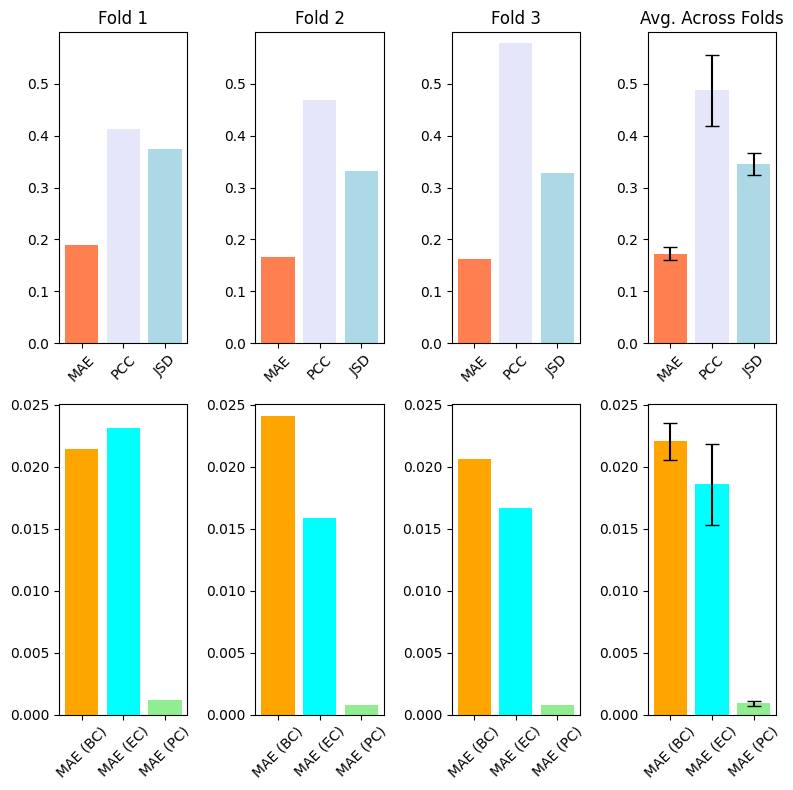

In [49]:
# Calculate the average and standard deviation of the results for each metric
pivoted_cv_results = {metric: [] for metric in cv_results[0].keys()}
for fold_results in cv_results:
    for metric, value in fold_results.items():
        pivoted_cv_results[metric].append(value)

avg_results = {metric: np.mean(values) for metric, values in pivoted_cv_results.items()}
std_results = {metric: np.std(values) for metric, values in pivoted_cv_results.items()}

# Define the colors for the bars
colors_main = ['coral', 'lavender', 'lightblue']
colors_sub = ['orange', 'cyan', 'lightgreen']

main_metrics = ['mae', 'pcc', 'js_dis']
sub_metrics = ['avg_mae_bc', 'avg_mae_ec', 'avg_mae_pc']


# Create a mapping for the metrics to their display names
metric_display_names = {
    'mae': 'MAE',
    'pcc': 'PCC',
    'js_dis': 'JSD',
    'avg_mae_bc': 'MAE (BC)',
    'avg_mae_ec': 'MAE (EC)',
    'avg_mae_pc': 'MAE (PC)'
}

# Function to create subplots for a given set of metrics
def create_subplot(ax, fold_data, avg_data, std_data, metrics, colors, title=None, with_error=False):
    display_metrics = [metric_display_names[metric] for metric in metrics]
    ax.bar(display_metrics, [fold_data.get(metric, 0) for metric in metrics], color=colors)
    if title:
        ax.set_title(title)
    ax.tick_params(axis='x', rotation=45)
    if with_error:  # Add error bars for the average plot
        ax.errorbar(display_metrics, [avg_data.get(metric, 0) for metric in metrics],
                    yerr=[std_data.get(metric, 0) for metric in metrics], fmt='none', capsize=5, color='black')

# Create a 2x4 grid of subplots
fig, axs = plt.subplots(2, 4, figsize=(8, 8))

# Calculate max and min values for each row to align the y-axis
max_values_main = max([max([fold_data.get(metric, 0) for metric in main_metrics]) for fold_data in cv_results] + 
                      [avg_results.get(metric, 0) + std_results.get(metric, 0) for metric in main_metrics])
max_values_sub = max([max([fold_data.get(metric, 0) for metric in sub_metrics]) for fold_data in cv_results] + 
                     [avg_results.get(metric, 0) + std_results.get(metric, 0) for metric in sub_metrics])

# Plot the main metrics for each fold
for i in range(3):
    create_subplot(axs[0, i], cv_results[i], avg_results, std_results, main_metrics, colors_main, f'Fold {i + 1}')

# Plot the average across folds for main metrics
create_subplot(axs[0, 3], avg_results, avg_results, std_results, main_metrics, colors_main, 'Avg. Across Folds', with_error=True)

# Set y-axis limits for the first row
for ax in axs[0, :]:
    ax.set_ylim(0, max_values_main+0.02)

# Plot the sub metrics for each fold
for i in range(3):
    create_subplot(axs[1, i], cv_results[i], avg_results, std_results, sub_metrics, colors_sub)

# Plot the average across folds for sub metrics
create_subplot(axs[1, 3], avg_results, avg_results, std_results, sub_metrics, colors_sub, with_error=True)

# Set y-axis limits for the second row
for ax in axs[1, :]:
    ax.set_ylim(0, max_values_sub+0.001)

plt.tight_layout()

# Assuming dirpath is defined and points to a valid directory path
filepath = dirpath + 'bar_chart_results.png'
plt.savefig(filepath, dpi=400)
plt.show()



In [50]:
#get average results
avg_results

{'mae': 0.17259729,
 'pcc': 0.48744129892068955,
 'js_dis': 0.3450218517288088,
 'avg_mae_bc': 0.02203613199256445,
 'avg_mae_ec': 0.018567047866533622,
 'avg_mae_pc': 0.0009123705117704593}

In [51]:
#compute GPU usage
memory_df = pd.DataFrame(memory_log)
average_memory_usage = memory_df.iloc[:, 0].mean()
max_memory_usage = memory_df.iloc[:, 0].max()

print(f'Average GPU memory usage: {round(average_memory_usage/1024**2, 2)} MB')
print(f'Maximum GPU memory usage: {round(max_memory_usage/1024**2, 2)} MB')

Average GPU memory usage: 7719.45 MB
Maximum GPU memory usage: 11395.0 MB
